# Explore here

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

from sklearn.metrics import silhouette_score

from sklearn.model_selection import train_test_split

from sklearn.cluster import KMeans

from sklearn.ensemble import RandomForestClassifier

from sklearn.metrics import classification_report, accuracy_score




In [2]:
housing = pd.read_csv ("https://raw.githubusercontent.com/4GeeksAcademy/k-means-project-tutorial/main/housing.csv")

housing.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MedHouseVal
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


In [3]:
housing_final = housing[["MedInc", "Latitude", "Longitude"]]

housing_final.head()

,MedInc,Latitude,Longitude
0,8.3252,37.88,-122.23
1,8.3014,37.86,-122.22
2,7.2574,37.85,-122.24
3,5.6431,37.85,-122.25
4,3.8462,37.85,-122.25


In [4]:
# Dividimos el dataset y entrenamos el modelo

train_data, test_data = train_test_split(housing_final, test_size = 0.2, random_state = 42)

modelo_kmeans = KMeans(n_clusters=6, random_state=42)

modelo_kmeans.fit(train_data)

KMeans(n_clusters=6, random_state=42)

In [5]:
#Añadimos la columna 'cluster' al dataset 
train_data['cluster'] = modelo_kmeans.labels_

train_data.head()

,MedInc,Latitude,Longitude,cluster
14196,3.2596,32.71,-117.03,3
8267,3.8125,33.77,-118.16,1
17445,4.1563,34.66,-120.48,1
14265,1.9425,32.69,-117.11,3
2271,3.5542,36.78,-119.80,5


In [6]:
# Creamos una copia del dataset original

housing_cluster = housing_final.copy()

# Asignamos a cada fila del conjunto de datos el clúster al que pertenece según el modelo entrenado
housing_cluster ['cluster'] = modelo_kmeans.predict(housing_final)

housing_cluster.head()

,MedInc,Latitude,Longitude,cluster
0,8.3252,37.88,-122.23,0
1,8.3014,37.86,-122.22,0
2,7.2574,37.85,-122.24,0
3,5.6431,37.85,-122.25,0
4,3.8462,37.85,-122.25,5


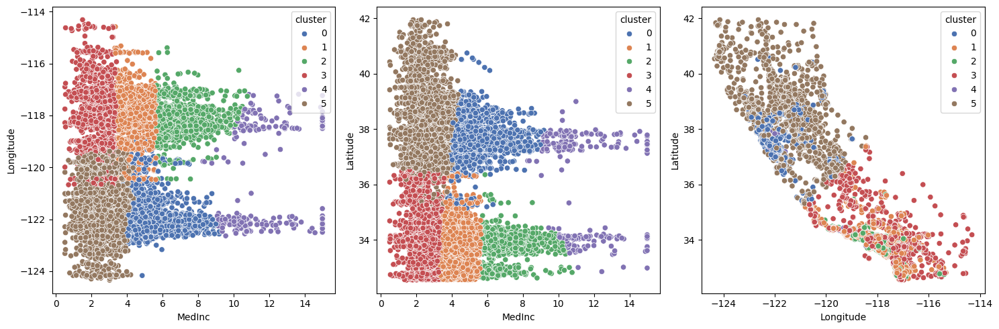

In [7]:
# Graficamos los clusters

fig, axis = plt.subplots(1, 3, figsize = (15, 5))

sns.scatterplot(ax = axis[0], data = train_data, x = "MedInc", y = "Longitude", hue = "cluster", palette = "deep")
sns.scatterplot(ax = axis[1], data = train_data, x = "MedInc", y = "Latitude", hue = "cluster", palette = "deep")
sns.scatterplot(ax = axis[2], data = train_data, x = "Longitude", y = "Latitude", hue = "cluster", palette = "deep")
plt.tight_layout()

plt.show()

In [8]:
import folium

map_center = [housing_final['Latitude'].mean(), housing_final['Longitude'].mean()]  
m = folium.Map(location=map_center, zoom_start=10)

colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkblue']

for idx, row in housing_cluster.iterrows():
    cluster_index = int(row['cluster'])
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']], 
        radius=6,  
        color=colors[cluster_index],  
        fill=True,
        fill_color=colors[cluster_index], 
        fill_opacity=0.6,
        popup=f"Cluster {cluster_index}" 
    ).add_to(m)

m    


Al analizar las gráficas y el mapa con la ubicación de las casas, podemos ver que las casas con mayores ingresos se encuentran alejadas de los núcleos poblacionales, mientras que al acercarnos a las ciudades el ingreso medio de las casas es menor.

In [9]:
test_data['cluster'] = modelo_kmeans.predict(test_data)

test_data.head()

,MedInc,Latitude,Longitude,cluster
20046,1.6812,36.06,-119.01,3
3024,2.5313,35.14,-119.46,3
15663,3.4801,37.80,-122.44,5
20484,5.7376,34.28,-118.72,2
9814,3.7250,36.62,-121.93,5


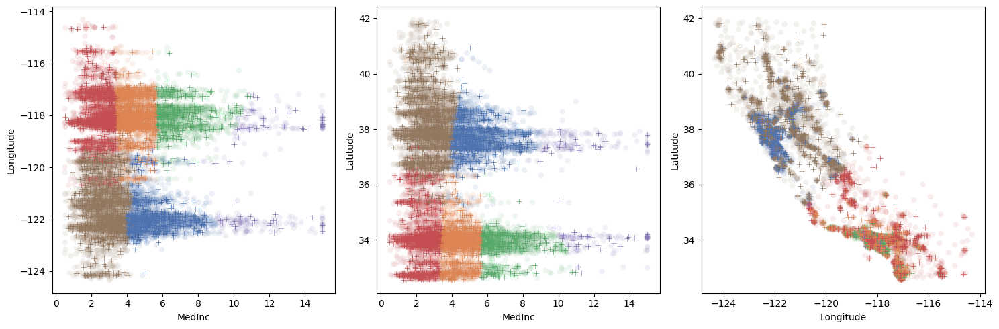

In [10]:
fig, axis = plt.subplots(1, 3, figsize = (15, 5))

sns.scatterplot(ax = axis[0], data = train_data, x = "MedInc", y = "Longitude", hue = "cluster", palette = "deep", alpha  = 0.1)
sns.scatterplot(ax = axis[1], data = train_data, x = "MedInc", y = "Latitude", hue = "cluster", palette = "deep", alpha  = 0.1)
sns.scatterplot(ax = axis[2], data = train_data, x = "Longitude", y = "Latitude", hue = "cluster", palette = "deep", alpha  = 0.1)

sns.scatterplot(ax = axis[0], data = test_data, x = "MedInc", y = "Longitude", hue = "cluster", palette = "deep", marker = "+")
sns.scatterplot(ax = axis[1], data = test_data, x = "MedInc", y = "Latitude", hue = "cluster", palette = "deep", marker = "+")
sns.scatterplot(ax = axis[2], data = test_data, x = "Longitude", y = "Latitude", hue = "cluster", palette = "deep", marker = "+")

plt.tight_layout()

for ax in axis:
    ax.legend([],[], frameon=False)

plt.show()

En las graficas podemos ver que hay muchisima fiabilidad en la predicción de nuestro modelo. Los marcadores '+' corresponden a los cluster predichos por nuestro modelo y se ajustan bastante a los cluster del dataset

Como modelo de clasificación supervisada vamos a elegir Random Forest

In [11]:
X_train = train_data.drop("cluster", axis=1)
y_train = train_data["cluster"]
X_test = test_data.drop("cluster", axis=1)
y_test = test_data["cluster"]

clasificador = RandomForestClassifier(random_state=42)
clasificador.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [12]:
y_pred = clasificador.predict (X_test)

In [20]:


print("Accuracy:", accuracy_score(y_test, y_pred))


Accuracy: 0.9963662790697675


In [21]:
from pickle import dump

dump(modelo_kmeans, open ("../models/k_means.sav", "wb"))
dump(clasificador, open("../models/random_forest_classifier.sav", "wb"))